In [1]:
import sys
sys.path.append('../../..')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from lib.carregamento import carregar_base_silver, info_base
from lib.visualizacao import grafico_barras, grafico_pizza, grafico_distribuicao
from lib.cores import aplicar_tema_agibank, PALETA_CATEGORICA, CORES_AGIBANK

aplicar_tema_agibank()

ModuleNotFoundError: No module named 'lib'

In [ ]:
df = carregar_base_silver()
info_base(df)

Carregando de: c:\Users\caroline.coutinho\projeto_mediacao_bancaria\analises\silver\notebooks_silver\..\..\..\data\silver\consumidor_gov_bronze_v2.csv
Base carregada com sucesso!
Registros: 2,567,095
Colunas: 30
INFORMACOES DA BASE

Total de registros: 2,567,095
Total de colunas: 30
Periodo: 2024 a 2025
Memoria utilizada: 4203.42 MB


# Análise do Perfil do Consumidor

## Objetivos:
- Identificar QUEM reclama (idade, sexo, localização)
- ONDE estão os consumidores (região, estado, cidade)
- COMO se comportam (canal, procurou empresa)
- QUANDO reclamam (temporal)
- Identificar PADRÕES e CORRELAÇÕES

In [2]:
# ============================================================
# CÉLULA 32: GRÁFICO 1 - TOP 5 SETORES (CORES AGIBANK)
# ============================================================

print("=" * 80)
print("GRAFICO 1: TOP 5 SETORES QUE MAIS RECLAMAM")
print("=" * 80)

# Preparar dados
top_setores = df_2025['segmento_de_mercado'].value_counts().head(5)
total = len(df_2025)

# Criar figura MODERNA
fig, ax = plt.subplots(figsize=(16, 9), facecolor='white')
ax.set_facecolor('white')

# Dados
y_pos = np.arange(len(top_setores))
valores = top_setores.values

# USAR PALETA AGIBANK (azul, verde, amarelo)
cores_barras = [
    CORES_AGIBANK['azul_principal'],  # 1º - AZUL (destaque máximo)
    CORES_AGIBANK['azul_medio'],      # 2º - Azul médio
    CORES_AGIBANK['verde'],           # 3º - VERDE
    CORES_AGIBANK['amarelo'],         # 4º - AMARELO
    CORES_AGIBANK['azul_escuro']      # 5º - Azul escuro
]

# Criar barras GROSSAS e modernas
for i, (y, valor, cor) in enumerate(zip(y_pos, valores, cores_barras)):
    ax.barh(y, valor, height=0.7, 
            color=cor, 
            edgecolor='white',
            linewidth=3)  # Borda branca grossa

# Labels simplificados
labels_curtos = []
for label in top_setores.index:
    if 'Bancos' in label:
        labels_curtos.append('Bancos e Financeiras')
    elif 'Operadoras' in label or 'Planos' in label or 'Saúde' in label:
        labels_curtos.append('Planos de Saúde')
    elif 'Telecomunicações' in label or 'Telefonia' in label:
        labels_curtos.append('Telecomunicações')
    elif 'Comércio' in label:
        labels_curtos.append('Comércio Eletrônico')
    elif 'Transporte' in label:
        labels_curtos.append('Transporte Aéreo')
    elif 'Pagamento' in label:
        labels_curtos.append('Pagamento Eletrônico')
    else:
        labels_curtos.append(label[:30])

# REMOVER eixo Y
ax.set_yticks([])

# Adicionar textos GRANDES e legíveis
for i, (valor, pct, label, cor) in enumerate(zip(valores, (valores/total)*100, labels_curtos, cores_barras)):
    
    # Nome do setor À ESQUERDA (grande e negrito)
    ax.text(-30000, i, label, 
            va='center', ha='right',
            fontsize=15, fontweight='700', 
            color=CORES_AGIBANK['azul_escuro'])
    
    # Valor DENTRO da barra (branco, grande)
    ax.text(valor/2, i, f'{valor:,}', 
            va='center', ha='center',
            fontsize=16, fontweight='bold', 
            color='white')
    
    # Percentual FORA da barra (colorido)
    ax.text(valor + 30000, i, f'{pct:.1f}%', 
            va='center', ha='left',
            fontsize=18, fontweight='bold', 
            color=cor)

# TÍTULO GRANDE E IMPACTANTE
fig.text(0.12, 0.95, 
        '1 em cada 3 reclamações é do Setor Financeiro',
        fontsize=22, fontweight='bold',
        color=CORES_AGIBANK['azul_escuro'])

fig.text(0.12, 0.91, 
        'Top 5 setores com mais reclamações no Brasil em 2025',
        fontsize=13, color='#666666')

# Remover bordas
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_xlabel('')
ax.set_xticks([])
ax.set_ylim(-0.8, len(top_setores) + 0.5)
ax.set_xlim(-50000, max(valores) + 150000)

# SEM grid (mais limpo)
ax.grid(False)

# Adicionar badge "DESTAQUE" no primeiro
ax.text(valores[0] + 30000, 0 + 0.35, 
        '⭐ LÍDER', 
        fontsize=11, fontweight='bold',
        color=CORES_AGIBANK['amarelo'],
        bbox=dict(boxstyle='round,pad=0.5', 
                  facecolor=CORES_AGIBANK['azul_escuro'], 
                  edgecolor='none'))

plt.tight_layout(rect=[0, 0, 1, 0.90])
plt.savefig(CAMINHO_OUTPUT / 'p1_top5_setores.png', dpi=300, bbox_inches='tight', facecolor='white')
plt.show()

print("\nv Grafico salvo em:", CAMINHO_OUTPUT / 'p1_top5_setores.png')

GRAFICO 1: TOP 5 SETORES QUE MAIS RECLAMAM


NameError: name 'df_2025' is not defined

## 1. Distribuição por Faixa Etária

In [ ]:
# ==============================================================================
# GRÁFICO 1: Barras horizontais PROFISSIONAL
# ==============================================================================
fig, ax = plt.subplots(figsize=(16, 10))
fig.patch.set_facecolor('white')
ax.set_facecolor('white')

# Cores da paleta Agibank
cores = [PALETA_CATEGORICA[i % len(PALETA_CATEGORICA)] for i in range(len(faixa_etaria))]

# Barras com altura reduzida para mais espaço
bars = ax.barh(faixa_etaria['Faixa Etária'], faixa_etaria['Total'], 
               color=cores, height=0.6, edgecolor='none')

# Valores e percentuais FORA das barras, alinhados
for i, (bar, row) in enumerate(zip(bars, faixa_etaria.itertuples())):
    width = bar.get_width()
    y_pos = bar.get_y() + bar.get_height()/2
    
    # Formatar números
    valor_formatado = f'{int(width):,}'.replace(',', '.')
    
    # Valor (negrito)
    ax.text(width + 15000, y_pos,
            valor_formatado,
            ha='left', va='center', 
            fontsize=13, fontweight='bold', 
            color='#1A1A1A')
    
    # Percentual (entre parênteses, mais discreto)
    ax.text(width + 80000, y_pos,
            f'({row.Percentual}%)',
            ha='left', va='center',
            fontsize=12,
            color='#666666')

# Remover bordas
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_color('#E0E0E0')
ax.spines['bottom'].set_linewidth(1)

# Grid vertical sutil
ax.grid(axis='x', alpha=0.15, linestyle='-', linewidth=0.8, color='#CCCCCC')
ax.set_axisbelow(True)

# Título principal
fig.text(0.125, 0.94, 
         'Adultos de 31-40 anos são o perfil que mais reclama',
         fontsize=22, fontweight='bold', color='#1A1A1A')

# Subtítulo
fig.text(0.125, 0.91,
         'Distribuição de 2,5 milhões de reclamações por faixa etária • 2024-2025',
         fontsize=13, color='#666666', style='italic')

# Eixo X
ax.set_xlabel('Total de Reclamações', fontsize=13, color='#4A4A4A', 
              labelpad=15, fontweight='500')
ax.set_ylabel('')

# Formatar eixo X
ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{int(x/1000)}k' if x > 0 else '0'))
ax.tick_params(axis='x', labelsize=11, colors='#4A4A4A', length=0, pad=10)

# Labels do eixo Y (faixas etárias) - mais espaço
ax.tick_params(axis='y', labelsize=12, colors='#1A1A1A', length=0, pad=15)

# Ajustar limites
ax.set_xlim(0, faixa_etaria['Total'].max() * 1.15)

# Margens
plt.tight_layout()
plt.subplots_adjust(left=0.18, right=0.97, top=0.90, bottom=0.08)
plt.show()

NameError: name 'plt' is not defined

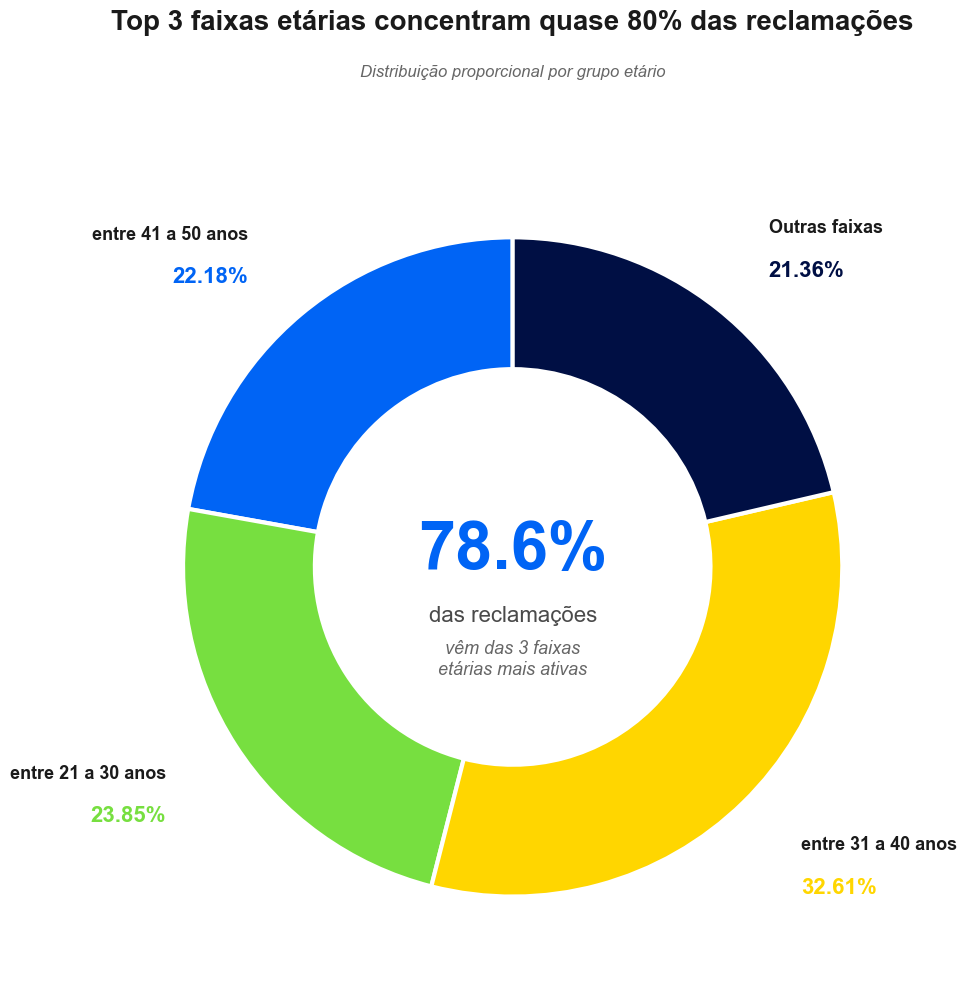

In [ ]:
# ==============================================================================
# GRÁFICO 2: DONUT CHART MELHORADO
# ==============================================================================
fig, ax = plt.subplots(figsize=(14, 10))
fig.patch.set_facecolor('white')

# Pegar top 3 e agrupar resto
top3 = faixa_etaria.tail(3).copy()
outros = faixa_etaria.head(len(faixa_etaria)-3)
outros_total = outros['Total'].sum()
outros_perc = outros['Percentual'].sum()

if outros_total > 0:
    outros_row = pd.DataFrame([{
        'Faixa Etária': 'Outras faixas',
        'Total': outros_total,
        'Percentual': outros_perc
    }])
    dados_plot = pd.concat([top3, outros_row], ignore_index=True)
else:
    dados_plot = top3

# Cores Agibank
cores_donut = [
    CORES_AGIBANK['azul_principal'],
    CORES_AGIBANK['verde'],
    CORES_AGIBANK['amarelo'],
    CORES_AGIBANK['azul_escuro']
][:len(dados_plot)]

# Criar donut SEM percentuais automáticos
wedges, texts = ax.pie(
    dados_plot['Total'],
    labels=None,
    colors=cores_donut,
    startangle=90,
    wedgeprops=dict(width=0.4, edgecolor='white', linewidth=3)
)

# Círculo branco no centro
centre_circle = plt.Circle((0, 0), 0.60, fc='white')
fig.gca().add_artist(centre_circle)

# Texto central
top3_total_perc = top3['Percentual'].sum()
ax.text(0, 0.05, f'{top3_total_perc:.1f}%',
        ha='center', va='center',
        fontsize=48, fontweight='bold',
        color=CORES_AGIBANK['azul_principal'])

ax.text(0, -0.15, 'das reclamações',
        ha='center', va='center',
        fontsize=16, color='#4A4A4A')

ax.text(0, -0.28, 'vêm das 3 faixas\netárias mais ativas',
        ha='center', va='center',
        fontsize=13, style='italic', color='#666666')

# Labels e percentuais FORA - mais próximos
for i, (wedge, row) in enumerate(zip(wedges, dados_plot.itertuples())):
    ang = (wedge.theta2 - wedge.theta1)/2 + wedge.theta1
    y = np.sin(np.deg2rad(ang))
    x = np.cos(np.deg2rad(ang))
    
    horizontalalignment = {-1: "right", 1: "left"}[int(np.sign(x))]
    
    # Posição mais próxima do gráfico
    x_label = x * 1.25
    y_label = y * 1.25
    
    # Nome da faixa
    ax.text(x_label, y_label + 0.05, row._1,
            ha=horizontalalignment, va='center',
            fontsize=13, fontweight='bold', color='#1A1A1A')
    
    # Percentual (colorido com a cor da fatia)
    ax.text(x_label, y_label - 0.08, f'{row.Percentual}%',
            ha=horizontalalignment, va='center',
            fontsize=16, fontweight='bold', color=cores_donut[i])

# Título
ax.text(0, 1.65, 'Top 3 faixas etárias concentram quase 80% das reclamações',
        ha='center', va='center',
        fontsize=20, fontweight='bold', color='#1A1A1A')

ax.text(0, 1.50, 'Distribuição proporcional por grupo etário',
        ha='center', va='center',
        fontsize=12, style='italic', color='#666666')

plt.tight_layout()
plt.show()

## 2. Distribuição por Sexo

PERFIL DE GÊNERO: ANÁLISE COMPARATIVA

💡 INSIGHT: Distribuição equilibrada - diferença de apenas 11.470000000000006%



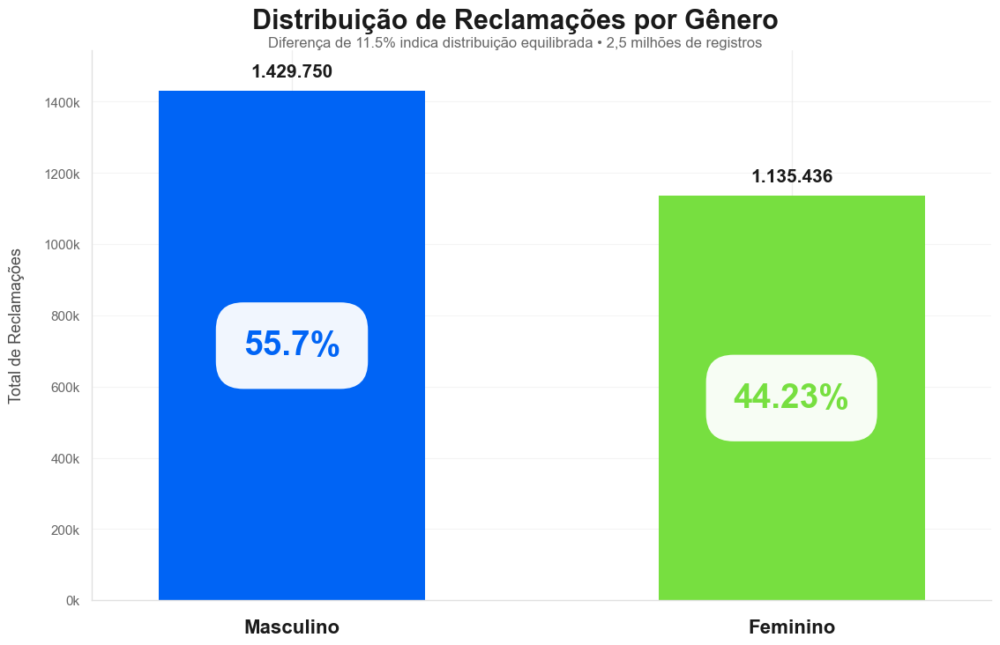


📊 RESUMO EXECUTIVO

• Masculino: 55.7% (1,429,750 reclamações)
• Feminino: 44.23% (1,135,436 reclamações)
• Diferença: 11.5 p.p.

💡 Conclusão: Estratégias universais, sem segmentação por gênero


In [ ]:
print("=" * 80)
print("PERFIL DE GÊNERO: ANÁLISE COMPARATIVA")
print("=" * 80)

# Preparar dados
sexo = df.groupby('Sexo').size().reset_index(name='Total')
sexo['Percentual'] = np.round((sexo['Total'] / len(df)) * 100, 2)
sexo = sexo[sexo['Sexo'].isin(['M', 'F'])].copy()
sexo = sexo.sort_values('Total', ascending=False)

masc = sexo[sexo['Sexo']=='M'].iloc[0]
fem = sexo[sexo['Sexo']=='F'].iloc[0]
diferenca_perc = abs(masc['Percentual'] - fem['Percentual'])

print(f"\n💡 INSIGHT: Distribuição equilibrada - diferença de apenas {diferenca_perc}%\n")

# ==============================================================================
# GRÁFICO CORPORATIVO
# ==============================================================================
fig, ax = plt.subplots(figsize=(12, 8))
fig.patch.set_facecolor('white')
ax.set_facecolor('white')

# Posições e cores
x_positions = [0, 1.5]
bar_width = 0.8
cores = [CORES_AGIBANK['azul_principal'], CORES_AGIBANK['verde']]

# Criar barras
bars = ax.bar(x_positions, sexo['Total'], 
              color=cores, width=bar_width, 
              edgecolor='none')

# Adicionar textos
for i, (bar, row) in enumerate(zip(bars, sexo.itertuples())):
    x_pos = bar.get_x() + bar.get_width()/2
    height = bar.get_height()
    
    # Percentual DENTRO da barra com fundo branco
    ax.text(x_pos, height * 0.50, f'{row.Percentual}%',
           ha='center', va='center',
           fontsize=28, fontweight='bold',
           color=cores[i],
           bbox=dict(boxstyle='round,pad=0.8', 
                    facecolor='white', 
                    edgecolor='none',
                    alpha=0.95))
    
    # Valor ACIMA da barra
    valor_formatado = f'{int(row.Total):,}'.replace(',', '.')
    ax.text(x_pos, height + 30000, valor_formatado,
           ha='center', va='bottom',
           fontsize=15, fontweight='bold',
           color='#1A1A1A')

# Labels embaixo
labels_map = {'M': 'Masculino', 'F': 'Feminino'}
ax.set_xticks(x_positions)
ax.set_xticklabels([labels_map[s] for s in sexo['Sexo']], 
                   fontsize=16, color='#1A1A1A', fontweight='600')
ax.tick_params(axis='x', length=0, pad=15)

# Configurar eixo Y
ax.set_ylabel('Total de Reclamações', fontsize=13, color='#4A4A4A', 
              fontweight='500', labelpad=15)
ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{int(x/1000)}k'))
ax.tick_params(axis='y', labelsize=11, colors='#666666', length=0, pad=10)

# Grid horizontal
ax.grid(axis='y', alpha=0.2, linestyle='-', linewidth=0.8, color='#CCCCCC', zorder=0)
ax.set_axisbelow(True)

# Bordas
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_color('#E0E0E0')
ax.spines['left'].set_linewidth(1)
ax.spines['bottom'].set_color('#E0E0E0')
ax.spines['bottom'].set_linewidth(1)

# Ajustar limites
ax.set_ylim(0, sexo['Total'].max() * 1.08)
ax.set_xlim(-0.6, 2.1)

# Título
fig.text(0.5, 0.94, 'Distribuição de Reclamações por Gênero',
         fontsize=22, fontweight='bold', color='#1A1A1A', 
         ha='center', va='top')

fig.text(0.5, 0.90, f'Diferença de {diferenca_perc:.1f}% indica distribuição equilibrada • 2,5 milhões de registros',
         fontsize=12, color='#666666',
         ha='center', va='top')

plt.tight_layout()
plt.subplots_adjust(left=0.10, right=0.95, top=0.88, bottom=0.10)
plt.show()

# RESUMO
print("\n" + "="*80)
print("📊 RESUMO EXECUTIVO")
print("="*80)
print(f"\n• Masculino: {masc['Percentual']}% ({int(masc['Total']):,} reclamações)")
print(f"• Feminino: {fem['Percentual']}% ({int(fem['Total']):,} reclamações)")
print(f"• Diferença: {diferenca_perc:.1f} p.p.")
print(f"\n💡 Conclusão: Estratégias universais, sem segmentação por gênero")
print("="*80)

## 3. Distribuição Geográfica (Região e UF)

In [ ]:
import plotly.express as px
import json
import os
from pathlib import Path

print("=" * 80)
print("MAPA DE CALOR GEOGRÁFICO - BRASIL")
print("=" * 80)

# ==============================================================================
# CARREGAR DADOS USANDO NOSSA LIB
# ==============================================================================
# Dados já carregados do df anterior, mas se precisar recarregar:
# from lib.carregamento import carregar_base_silver
# df = carregar_base_silver()

print(f"✓ Base em uso: {len(df):,} registros")
print(f"✓ Período: {df['Ano Abertura'].min()} - {df['Ano Abertura'].max()}")

# ==============================================================================
# CARREGAR GEOJSON
# ==============================================================================
# Caminho do GeoJSON na raiz do projeto
raiz_projeto = Path(os.getcwd()).parent.parent.parent
caminho_json = raiz_projeto / 'brasil.json'

with open(caminho_json, 'r', encoding='utf-8') as f:
    brazil_geojson = json.load(f)

print(f"✓ GeoJSON carregado: {len(brazil_geojson['features'])} estados")

# ==============================================================================
# PREPARAR DADOS
# ==============================================================================
uf_dados = df.groupby('UF').size().reset_index(name='Total')
uf_dados['Percentual'] = np.round((uf_dados['Total'] / len(df)) * 100, 2)

# Nomes dos estados
nomes_estados = {
    'AC': 'Acre', 'AL': 'Alagoas', 'AP': 'Amapá', 'AM': 'Amazonas',
    'BA': 'Bahia', 'CE': 'Ceará', 'DF': 'Distrito Federal', 'ES': 'Espírito Santo',
    'GO': 'Goiás', 'MA': 'Maranhão', 'MT': 'Mato Grosso', 'MS': 'Mato Grosso do Sul',
    'MG': 'Minas Gerais', 'PA': 'Pará', 'PB': 'Paraíba', 'PR': 'Paraná',
    'PE': 'Pernambuco', 'PI': 'Piauí', 'RJ': 'Rio de Janeiro', 'RN': 'Rio Grande do Norte',
    'RS': 'Rio Grande do Sul', 'RO': 'Rondônia', 'RR': 'Roraima', 'SC': 'Santa Catarina',
    'SP': 'São Paulo', 'SE': 'Sergipe', 'TO': 'Tocantins'
}

uf_dados['Estado'] = uf_dados['UF'].map(nomes_estados)

print(f"\n📊 Top 5 Estados:")
display(uf_dados.nlargest(5, 'Total')[['Estado', 'UF', 'Total', 'Percentual']])

# ==============================================================================
# CRIAR MAPA DE CALOR COM CORES AGIBANK
# ==============================================================================
fig = px.choropleth(
    uf_dados,
    geojson=brazil_geojson,
    locations='UF',
    featureidkey='properties.sigla',
    color='Total',
    hover_name='Estado',
    hover_data={
        'UF': True,
        'Total': ':,',
        'Percentual': ':.2f%',
        'Estado': False
    },
    color_continuous_scale=[
        [0, '#FFFFFF'],
        [0.3, CORES_AGIBANK['verde_claro']],
        [0.6, CORES_AGIBANK['verde']],
        [0.8, CORES_AGIBANK['amarelo']],
        [1, CORES_AGIBANK['azul_principal']]
    ],
    labels={'Total': 'Reclamações'}
)

# Configurar visualização
fig.update_geos(
    fitbounds="locations",
    visible=False,
    bgcolor='white'
)

# Layout
fig.update_layout(
    title={
        'text': '<b>Mapa de Calor: Concentração de Reclamações por Estado</b><br>' +
                '<sub>Quanto mais escuro, maior o volume • Consumidor.gov.br</sub>',
        'x': 0.5,
        'xanchor': 'center',
        'font': {'size': 22, 'color': '#1A1A1A', 'family': 'Arial'}
    },
    height=800,
    paper_bgcolor='white',
    geo=dict(bgcolor='white'),
    margin=dict(t=120, l=10, r=10, b=20),
    coloraxis_colorbar={
        'title': {'text': 'Reclamações', 'font': {'size': 14}},
        'thickness': 25,
        'len': 0.7,
        'tickformat': ',',
        'tickfont': {'size': 12}
    }
)

# Bordas dos estados
fig.update_traces(
    marker_line_color='white',
    marker_line_width=1.5
)

fig.show()

# ==============================================================================
# ESTATÍSTICAS GEOGRÁFICAS
# ==============================================================================
print("\n" + "="*80)
print("📊 ESTATÍSTICAS GEOGRÁFICAS")
print("="*80)

estado_max = uf_dados.nlargest(1, 'Total').iloc[0]
estado_min = uf_dados.nsmallest(1, 'Total').iloc[0]

print(f"\n🔴 Estado com MAIS reclamações:")
print(f"   {estado_max['Estado']} ({estado_max['UF']}): {estado_max['Total']:,} ({estado_max['Percentual']}%)")

print(f"\n🟢 Estado com MENOS reclamações:")
print(f"   {estado_min['Estado']} ({estado_min['UF']}): {estado_min['Total']:,} ({estado_min['Percentual']}%)")

print(f"\n📈 Estatísticas:")
print(f"   • Média: {uf_dados['Total'].mean():.0f} reclamações/estado")
print(f"   • Mediana: {uf_dados['Total'].median():.0f}")
print(f"   • Total: {uf_dados['Total'].sum():,}")

print("="*80)




MAPA DE CALOR GEOGRÁFICO - BRASIL
✓ Base em uso: 2,567,095 registros
✓ Período: 2024 - 2025
✓ GeoJSON carregado: 27 estados

📊 Top 5 Estados:


,Estado,UF,Total,Percentual
25,São Paulo,SP,649651,25.31
10,Minas Gerais,MG,299999,11.69
18,Rio de Janeiro,RJ,261590,10.19
17,Paraná,PR,177952,6.93
4,Bahia,BA,151795,5.91



📊 ESTATÍSTICAS GEOGRÁFICAS

🔴 Estado com MAIS reclamações:
   São Paulo (SP): 649,651 (25.31%)

🟢 Estado com MENOS reclamações:
   Roraima (RR): 6,076 (0.24%)

📈 Estatísticas:
   • Média: 95078 reclamações/estado
   • Mediana: 49463
   • Total: 2,567,095


In [ ]:
import plotly.graph_objects as go
import plotly.express as px
from pathlib import Path
import json

print("=" * 80)
print("MAPA INTERATIVO DE CALOR - BRASIL")
print("=" * 80)

# Dados já carregados (df já existe)
print(f"✓ Base: {len(df):,} registros")

# ==============================================================================
# CARREGAR GEOJSON
# ==============================================================================
raiz_projeto = Path(os.getcwd()).parent.parent.parent
caminho_json = raiz_projeto / 'brasil.json'

with open(caminho_json, 'r', encoding='utf-8') as f:
    brazil_geojson = json.load(f)

# ==============================================================================
# PREPARAR DADOS AGREGADOS
# ==============================================================================
uf_dados = df.groupby('UF').agg({
    'UF': 'count'
}).rename(columns={'UF': 'Total'}).reset_index()

uf_dados = df.groupby('UF').size().reset_index(name='Total')
uf_dados['Percentual'] = np.round((uf_dados['Total'] / len(df)) * 100, 2)

# Adicionar mais métricas para interatividade
uf_dados['Nota_Media'] = df.groupby('UF')['Nota do Consumidor'].mean().round(2).values
uf_dados['Tempo_Medio'] = df.groupby('UF')['Tempo Resposta'].mean().round(1).values

# Nomes dos estados
nomes_estados = {
    'AC': 'Acre', 'AL': 'Alagoas', 'AP': 'Amapá', 'AM': 'Amazonas',
    'BA': 'Bahia', 'CE': 'Ceará', 'DF': 'Distrito Federal', 'ES': 'Espírito Santo',
    'GO': 'Goiás', 'MA': 'Maranhão', 'MT': 'Mato Grosso', 'MS': 'Mato Grosso do Sul',
    'MG': 'Minas Gerais', 'PA': 'Pará', 'PB': 'Paraíba', 'PR': 'Paraná',
    'PE': 'Pernambuco', 'PI': 'Piauí', 'RJ': 'Rio de Janeiro', 'RN': 'Rio Grande do Norte',
    'RS': 'Rio Grande do Sul', 'RO': 'Rondônia', 'RR': 'Roraima', 'SC': 'Santa Catarina',
    'SP': 'São Paulo', 'SE': 'Sergipe', 'TO': 'Tocantins'
}

uf_dados['Estado'] = uf_dados['UF'].map(nomes_estados)

print(f"\n📊 Top 5 Estados:")
display(uf_dados.nlargest(5, 'Total')[['Estado', 'Total', 'Percentual', 'Nota_Media']])

# ==============================================================================
# MAPA INTERATIVO COM CORES AGIBANK MAIS VISÍVEIS
# ==============================================================================
fig = px.choropleth(
    uf_dados,
    geojson=brazil_geojson,
    locations='UF',
    featureidkey='properties.sigla',
    color='Total',
    hover_name='Estado',
    hover_data={
        'UF': True,
        'Total': ':,',
        'Percentual': ':.2f%',
        'Nota_Media': ':.2f',
        'Tempo_Medio': ':.1f',
        'Estado': False
    },
    color_continuous_scale=[
        [0.0, CORES_AGIBANK['verde_claro']],      # Mínimo mais visível
        [0.4, CORES_AGIBANK['verde']],
        [0.6, CORES_AGIBANK['amarelo']],
        [0.8, '#FF8C00'],                          # Laranja
        [1.0, CORES_AGIBANK['azul_principal']]    # Máximo
    ],
    labels={'Total': 'Reclamações'}
)

# Customizar hover template
fig.update_traces(
    hovertemplate='<b>%{customdata[0]}</b><br>' +
                  '<br>' +
                  '📊 Total: %{customdata[1]:,} reclamações<br>' +
                  '📈 Percentual: %{customdata[2]:.2f}%<br>' +
                  '⭐ Nota Média: %{customdata[3]:.2f}/5<br>' +
                  '⏱️ Tempo Médio: %{customdata[4]:.1f} dias<br>' +
                  '<extra></extra>',
    customdata=uf_dados[['Estado', 'Total', 'Percentual', 'Nota_Media', 'Tempo_Medio']].values,
    marker_line_color='white',
    marker_line_width=2
)

# Configurar mapa
fig.update_geos(
    fitbounds="locations",
    visible=False,
    bgcolor='white'
)

fig.update_layout(
    title={
        'text': (
            f'<b style="color:{CORES_AGIBANK["azul_escuro"]}">Mapa de Calor: Reclamações Bancárias</b><br>'
            '<span style="font-size:13px; color:#666666">Análise Geográfica Estratégica por Estado</span>'
        ),
        'x': 0.5,
        'xanchor': 'center',
        'font': {'size': 24, 'family': 'Arial'}
    },
    height=650,  # ← DIMINUA AQUI (era 850)
    paper_bgcolor='#FAFAFA',
    geo=dict(bgcolor=CORES_AGIBANK['branco']),
    margin=dict(t=100, l=10, r=75, b=20),  # ← Reduza as margens também
    
    hoverlabel=dict(
        bgcolor='rgba(255, 255, 255, 0.98)',
        font_size=13,
        font_family='Arial, sans-serif',
        font_color='#1a1a1a',
        bordercolor='#aaaaaa',
        align='left',
        namelength=-1
    ),
    
    font=dict(family='Arial', size=13, color='#1a1a1a')
)

# Adicionar botões de interatividade
fig.update_layout(
    updatemenus=[
        dict(
            type="buttons",
            direction="left",
            buttons=[
                dict(
                    args=[{"colorscale": [[0, CORES_AGIBANK['verde_claro']], 
                                         [0.5, CORES_AGIBANK['verde']], 
                                         [1, CORES_AGIBANK['azul_principal']]]}],
                    label="Verde → Azul",
                    method="restyle"
                ),
                dict(
                    args=[{"colorscale": [[0, '#FEE5D9'], 
                                         [0.5, '#FC9272'], 
                                         [1, '#A50F15']]}],
                    label="Vermelho",
                    method="restyle"
                )
            ],
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.01,
            xanchor="left",
            y=1.08,
            yanchor="top"
        ),
    ]
)

fig.show()

# ==============================================================================
# ESTATÍSTICAS DETALHADAS
# ==============================================================================
print("\n" + "="*80)
print("📊 ESTATÍSTICAS GEOGRÁFICAS")
print("="*80)

estado_max = uf_dados.nlargest(1, 'Total').iloc[0]
estado_min = uf_dados.nsmallest(1, 'Total').iloc[0]

print(f"\n🔴 MAIOR volume:")
print(f"   {estado_max['Estado']} ({estado_max['UF']}): {estado_max['Total']:,} reclamações ({estado_max['Percentual']}%)")
print(f"   Nota média: {estado_max['Nota_Media']}/5 | Tempo: {estado_max['Tempo_Medio']} dias")

print(f"\n🟢 MENOR volume:")
print(f"   {estado_min['Estado']} ({estado_min['UF']}): {estado_min['Total']:,} reclamações ({estado_min['Percentual']}%)")
print(f"   Nota média: {estado_min['Nota_Media']}/5 | Tempo: {estado_min['Tempo_Medio']} dias")

print(f"\n📈 Distribuição por Região:")
regioes = {
    'Norte': ['AC', 'AP', 'AM', 'PA', 'RO', 'RR', 'TO'],
    'Nordeste': ['AL', 'BA', 'CE', 'MA', 'PB', 'PE', 'PI', 'RN', 'SE'],
    'Centro-Oeste': ['DF', 'GO', 'MT', 'MS'],
    'Sudeste': ['ES', 'MG', 'RJ', 'SP'],
    'Sul': ['PR', 'RS', 'SC']
}

for regiao, estados in regioes.items():
    total = uf_dados[uf_dados['UF'].isin(estados)]['Total'].sum()
    perc = (total / uf_dados['Total'].sum()) * 100
    print(f"   • {regiao:15s}: {total:>8,} ({perc:>5.1f}%)")

print("="*80)

MAPA INTERATIVO DE CALOR - BRASIL
✓ Base: 2,567,095 registros

📊 Top 5 Estados:


,Estado,Total,Percentual,Nota_Media
25,São Paulo,649651,25.31,2.53
10,Minas Gerais,299999,11.69,2.52
18,Rio de Janeiro,261590,10.19,2.58
17,Paraná,177952,6.93,2.61
4,Bahia,151795,5.91,2.50



📊 ESTATÍSTICAS GEOGRÁFICAS

🔴 MAIOR volume:
   São Paulo (SP): 649,651 reclamações (25.31%)
   Nota média: 2.53/5 | Tempo: 6.2 dias

🟢 MENOR volume:
   Roraima (RR): 6,076 reclamações (0.24%)
   Nota média: 2.81/5 | Tempo: 5.7 dias

📈 Distribuição por Região:
   • Norte          :  141,610 (  5.5%)
   • Nordeste       :  488,253 ( 19.0%)
   • Centro-Oeste   :  263,641 ( 10.3%)
   • Sudeste        : 1,262,212 ( 49.2%)
   • Sul            :  411,379 ( 16.0%)


In [ ]:
import plotly.graph_objects as go
from pathlib import Path
import json

print("=" * 80)
print("DASHBOARD INTERATIVO - ANÁLISE GEOGRÁFICA")
print("=" * 80)

# ==============================================================================
# CARREGAR GEOJSON
# ==============================================================================
raiz_projeto = Path(os.getcwd()).parent.parent.parent
caminho_json = raiz_projeto / 'brasil.json'

with open(caminho_json, 'r', encoding='utf-8') as f:
    brazil_geojson = json.load(f)

print(f"✓ Dados: {len(df):,} registros | Estados: {len(brazil_geojson['features'])}")

# ==============================================================================
# PREPARAR DADOS COMPLETOS
# ==============================================================================
uf_dados = df.groupby('UF').agg({
    'UF': 'size',
    'Nota do Consumidor': 'mean',
    'Tempo Resposta': 'mean'
}).rename(columns={'UF': 'Total'}).reset_index()

uf_dados.columns = ['UF', 'Total', 'Nota_Media', 'Tempo_Medio']
uf_dados['Percentual'] = np.round((uf_dados['Total'] / len(df)) * 100, 2)
uf_dados['Nota_Media'] = uf_dados['Nota_Media'].round(2)
uf_dados['Tempo_Medio'] = uf_dados['Tempo_Medio'].round(1)

# Calcular ranking
uf_dados['Ranking'] = uf_dados['Total'].rank(ascending=False).astype(int)

# Classificação por volume
uf_dados['Classificacao'] = pd.cut(
    uf_dados['Total'],
    bins=[0, 50000, 150000, 300000, float('inf')],
    labels=['Baixo', 'Médio', 'Alto', 'Crítico']
)

# Nomes dos estados
nomes_estados = {
    'AC': 'Acre', 'AL': 'Alagoas', 'AP': 'Amapá', 'AM': 'Amazonas',
    'BA': 'Bahia', 'CE': 'Ceará', 'DF': 'Distrito Federal', 'ES': 'Espírito Santo',
    'GO': 'Goiás', 'MA': 'Maranhão', 'MT': 'Mato Grosso', 'MS': 'Mato Grosso do Sul',
    'MG': 'Minas Gerais', 'PA': 'Pará', 'PB': 'Paraíba', 'PR': 'Paraná',
    'PE': 'Pernambuco', 'PI': 'Piauí', 'RJ': 'Rio de Janeiro', 'RN': 'Rio Grande do Norte',
    'RS': 'Rio Grande do Sul', 'RO': 'Rondônia', 'RR': 'Roraima', 'SC': 'Santa Catarina',
    'SP': 'São Paulo', 'SE': 'Sergipe', 'TO': 'Tocantins'
}

uf_dados['Estado'] = uf_dados['UF'].map(nomes_estados)

# ==============================================================================
# CRIAR MAPA INTERATIVO AVANÇADO
# ==============================================================================
fig = go.Figure()

# Adicionar choropleth
fig.add_trace(go.Choropleth(
    geojson=brazil_geojson,
    locations=uf_dados['UF'],
    z=uf_dados['Total'],
    featureidkey='properties.sigla',
    colorscale=[
        [0.0, CORES_AGIBANK['verde_claro']],
        [0.3, CORES_AGIBANK['verde']],
        [0.5, CORES_AGIBANK['amarelo']],
        [0.7, '#FF8C00'],
        [1.0, CORES_AGIBANK['azul_principal']]
    ],
    marker_line_color='white',
    marker_line_width=2,
    colorbar=dict(
        title=dict(
            text='<b>Volume de<br>Reclamações</b>',
            font=dict(size=13, family='Arial', color='#1A1A1A')
        ),
        thickness=30,
        len=0.7,
        x=1.02,
        tickformat=',',
        tickfont=dict(size=11)
    ),
    hovertemplate='<b>%{customdata[0]}</b> (%{location})<br><br>' +
                  '<b>Volume:</b> %{customdata[1]:,} reclamações<br>' +
                  '<b>Participação:</b> %{customdata[2]:.2f}%<br>' +
                  '<b>Ranking:</b> %{customdata[3]}º lugar<br>' +
                  '<b>Classificação:</b> %{customdata[4]}<br>' +
                  '<br>' +
                  '<b>Nota Média:</b> %{customdata[5]:.2f}/5.0<br>' +
                  '<b>Tempo Médio:</b> %{customdata[6]:.1f} dias<br>' +
                  '<extra></extra>',
    customdata=uf_dados[['Estado', 'Total', 'Percentual', 'Ranking', 
                         'Classificacao', 'Nota_Media', 'Tempo_Medio']].values
))

# Configurar mapa
fig.update_geos(
    fitbounds="locations",
    visible=False,
    bgcolor='white'
)

# Layout profissional
fig.update_layout(
    title={
        'text': '<b>Mapa de Calor Interativo: Distribuição Geográfica de Reclamações</b><br>' +
                '<sub>Análise por Estado • Hover para detalhes • Scroll para zoom</sub>',
        'x': 0.5,
        'xanchor': 'center',
        'font': {'size': 24, 'color': '#1A1A1A', 'family': 'Arial'}
    },
    height=900,
    paper_bgcolor='white',
    geo=dict(bgcolor='white'),
    margin=dict(t=140, l=10, r=80, b=20),
    hoverlabel=dict(
        bgcolor='white',
        font_size=14,
        font_family='Arial',
        bordercolor='#DDDDDD',
        align='left'
    ),
    font=dict(family='Arial', size=12, color='#333333')
)

fig.show()

# ==============================================================================
# ESTATÍSTICAS EXECUTIVAS
# ==============================================================================
print("\n" + "="*80)
print("ANÁLISE GEOGRÁFICA EXECUTIVA")
print("="*80)

# Top 3 e Bottom 3
print("\nTOP 3 ESTADOS (Maior Volume):")
for i, row in uf_dados.nlargest(3, 'Total').iterrows():
    print(f"  {row['Ranking']}º {row['Estado']:20s} | {row['Total']:>7,} reclamações | {row['Percentual']:>5.2f}% | Nota: {row['Nota_Media']:.2f}")

print("\nBOTTOM 3 ESTADOS (Menor Volume):")
for i, row in uf_dados.nsmallest(3, 'Total').iterrows():
    print(f"  {row['Ranking']}º {row['Estado']:20s} | {row['Total']:>7,} reclamações | {row['Percentual']:>5.2f}% | Nota: {row['Nota_Media']:.2f}")

# Análise por classificação
print("\nDISTRIBUIÇÃO POR CLASSIFICAÇÃO:")
for classe in ['Crítico', 'Alto', 'Médio', 'Baixo']:
    qtd = len(uf_dados[uf_dados['Classificacao'] == classe])
    if qtd > 0:
        estados = uf_dados[uf_dados['Classificacao'] == classe]['UF'].tolist()
        print(f"  {classe:10s}: {qtd} estados - {', '.join(estados)}")

print("="*80)

DASHBOARD INTERATIVO - ANÁLISE GEOGRÁFICA
✓ Dados: 2,567,095 registros | Estados: 27



ANÁLISE GEOGRÁFICA EXECUTIVA

TOP 3 ESTADOS (Maior Volume):
  1º São Paulo            | 649,651 reclamações | 25.31% | Nota: 2.53
  2º Minas Gerais         | 299,999 reclamações | 11.69% | Nota: 2.52
  3º Rio de Janeiro       | 261,590 reclamações | 10.19% | Nota: 2.58

BOTTOM 3 ESTADOS (Menor Volume):
  27º Roraima              |   6,076 reclamações |  0.24% | Nota: 2.81
  26º Amapá                |   7,153 reclamações |  0.28% | Nota: 2.84
  25º Acre                 |   7,302 reclamações |  0.28% | Nota: 2.86

DISTRIBUIÇÃO POR CLASSIFICAÇÃO:
  Crítico   : 1 estados - SP
  Alto      : 4 estados - BA, MG, PR, RJ
  Médio     : 8 estados - CE, DF, ES, GO, PA, PE, RS, SC
  Baixo     : 14 estados - AC, AL, AM, AP, MA, MS, MT, PB, PI, RN, RO, RR, SE, TO


In [ ]:
import plotly.graph_objects as go
from pathlib import Path
import json
import os
import pandas as pd
import numpy as np

# Importar cores Agibank
import sys
sys.path.append('../../../lib')
from cores import CORES_AGIBANK

print("=" * 80)
print("MAPA DE CALOR AGIBANK - ESPAÇAMENTO EQUILIBRADO")
print("=" * 80)

# ==============================================================================
# CARREGAR DADOS
# ==============================================================================
caminho_dados = '../../../data/silver/consumidor_gov_bronze_v2.csv'

df = pd.read_csv(
    caminho_dados,
    sep=';',
    encoding='utf-8',
    on_bad_lines='skip',
    low_memory=False
)

raiz_projeto = Path(os.getcwd()).parent.parent.parent
caminho_json = raiz_projeto / 'brasil.json'

with open(caminho_json, 'r', encoding='utf-8') as f:
    brazil_geojson = json.load(f)

# ==============================================================================
# PREPARAR DADOS
# ==============================================================================
uf_dados = df.groupby('UF').agg({
    'Nota do Consumidor': 'mean',
    'Tempo Resposta': 'mean'
}).reset_index()

uf_dados['Total'] = df.groupby('UF').size().values
uf_dados.columns = ['UF', 'Nota_Media', 'Tempo_Medio', 'Total']

uf_dados['Percentual'] = np.round((uf_dados['Total'] / len(df)) * 100, 2)
uf_dados['Nota_Media'] = uf_dados['Nota_Media'].round(2)
uf_dados['Tempo_Medio'] = uf_dados['Tempo_Medio'].round(1)
uf_dados['Ranking'] = uf_dados['Total'].rank(ascending=False).astype(int)

def classificar(total):
    if total > 300000:
        return '🔴 Crítico'
    elif total > 150000:
        return '🟠 Alto'
    elif total > 50000:
        return '🟡 Moderado'
    else:
        return '🟢 Controlado'

uf_dados['Status'] = uf_dados['Total'].apply(classificar)

nomes_estados = {
    'AC': 'Acre', 'AL': 'Alagoas', 'AP': 'Amapá', 'AM': 'Amazonas',
    'BA': 'Bahia', 'CE': 'Ceará', 'DF': 'Distrito Federal', 'ES': 'Espírito Santo',
    'GO': 'Goiás', 'MA': 'Maranhão', 'MT': 'Mato Grosso', 'MS': 'Mato Grosso do Sul',
    'MG': 'Minas Gerais', 'PA': 'Pará', 'PB': 'Paraíba', 'PR': 'Paraná',
    'PE': 'Pernambuco', 'PI': 'Piauí', 'RJ': 'Rio de Janeiro', 'RN': 'Rio Grande do Norte',
    'RS': 'Rio Grande do Sul', 'RO': 'Rondônia', 'RR': 'Roraima', 'SC': 'Santa Catarina',
    'SP': 'São Paulo', 'SE': 'Sergipe', 'TO': 'Tocantins'
}

uf_dados['Estado'] = uf_dados['UF'].map(nomes_estados)

print(f"✓ Dados processados: {len(uf_dados)} estados")

# ==============================================================================
# CRIAR MAPA COM ESPAÇAMENTO EQUILIBRADO
# ==============================================================================
fig = go.Figure()

fig.add_trace(go.Choropleth(
    geojson=brazil_geojson,
    locations=uf_dados['UF'],
    z=uf_dados['Total'],
    featureidkey='properties.sigla',
    colorscale=[
        [0.0, CORES_AGIBANK['verde_claro']],
        [0.3, CORES_AGIBANK['verde']],
        [0.5, CORES_AGIBANK['amarelo']],
        [0.7, '#FF8C00'],
        [1.0, CORES_AGIBANK['azul_escuro']]
    ],
    marker_line_color=CORES_AGIBANK['branco'],
    marker_line_width=2.5,
    colorbar=dict(
        title=dict(
            text='<b>Reclamações</b>',
            font=dict(size=14, family='Arial', color='#1a1a1a')
        ),
        thickness=22,
        len=0.65,
        x=1.01,
        tickformat=',',
        tickfont=dict(size=11, color='#333333'),
        bgcolor='rgba(255,255,255,0.95)',
        bordercolor='#CCCCCC',
        borderwidth=1
    ),
    # TOOLTIP COM ESPAÇAMENTO EQUILIBRADO
    hovertemplate=(
        '<br>'  # Padding TOP moderado
        
        # CABEÇALHO
        '    <b style="font-size:19px; color:#000f44">%{customdata[0]}</b> '
        '<span style="color:#777777">(%{location})</span>    <br>'
        '    <span style="font-size:11px; color:#999999">Ranking Nacional: %{customdata[3]}º de 27</span>    '
        '<br>'
        
        # DIVISOR
        '    <span style="color:#dddddd">──────────────────</span>    '
        '<br>'
        
        # VOLUME
        '    <span style="font-size:11px; color:#666666; font-weight:600">VOLUME</span>    <br>'
        '<br>' 
        '    <span style="font-size:20px; color:#000f44"><b>%{customdata[1]:,}</b></span>    <br>'
        '    <span style="font-size:11px; color:#777777">reclamações registradas</span>    <br>'
        '    <span style="font-size:10px; color:#999999">Representa %{customdata[2]:.2f}% do total nacional</span>    '
        '<br>'
        
        # DIVISOR
        '    <span style="color:#dddddd">──────────────────</span>    '
        '<br>'
        
        # STATUS
        '    <span style="font-size:11px; color:#666666; font-weight:600">STATUS OPERACIONAL</span>    <br>'
        '<br>' 
        '    <span style="font-size:15px; color:#333333"><b>%{customdata[7]}</b></span>    '
        '<br>'
        
        # DIVISOR
        '    <span style="color:#dddddd">──────────────────</span>    '
        '<br>'
        
        # SATISFAÇÃO
        '    <span style="font-size:11px; color:#666666; font-weight:600">⭐ SATISFAÇÃO DO CLIENTE</span>    <br>'
        '<br>' 
        '    <span style="font-size:20px; color:#000f44"><b>%{customdata[5]:.2f}</b></span> '
        '<span style="font-size:11px; color:#777777">de 5.0</span>    '
        '<br>'
        
        # DIVISOR
        '    <span style="color:#dddddd">──────────────────</span>    '
        '<br>'
        
        # TEMPO
        '    <span style="font-size:11px; color:#666666; font-weight:600">TEMPO MÉDIO DE RESPOSTA</span>    <br>'
        '<br>' 
        '    <span style="font-size:20px; color:#000f44"><b>%{customdata[6]:.1f}</b></span> '
        '<span style="font-size:11px; color:#777777">dias</span>    '
        
        '<br><br>'  # Padding BOTTOM moderado
        '<extra></extra>'
    ),
    customdata=uf_dados[['Estado', 'Total', 'Percentual', 'Ranking', 
                         'UF', 'Nota_Media', 'Tempo_Medio', 'Status']].values
))

fig.update_geos(
    fitbounds="locations",
    visible=False,
    bgcolor='#FAFAFA'
)

fig.update_layout(
    title={
        'text': (
            f'<b style="color:{CORES_AGIBANK["azul_escuro"]}">Mapa de Calor: Reclamações Bancárias</b><br>'
            '<span style="font-size:13px; color:#666666">Análise Geográfica Estratégica por Estado</span>'
        ),
        'x': 0.5,
        'xanchor': 'center',
        'font': {'size': 24, 'family': 'Arial'}
    },
    height=650,  # ← DIMINUA AQUI (era 850)
    paper_bgcolor='#FAFAFA',
    geo=dict(bgcolor=CORES_AGIBANK['branco']),
    margin=dict(t=100, l=10, r=75, b=20),  # ← Reduza as margens também
    
    hoverlabel=dict(
        bgcolor='rgba(255, 255, 255, 0.98)',
        font_size=13,
        font_family='Arial, sans-serif',
        font_color='#1a1a1a',
        bordercolor='#aaaaaa',
        align='left',
        namelength=-1
    ),
    
    font=dict(family='Arial', size=13, color='#1a1a1a')
)

# Legenda
fig.add_annotation(
    text=(
        f'<b style="color:{CORES_AGIBANK["azul_escuro"]}">LEGENDA</b><br><br>'
        '<span style="font-size:11px; color:#333333">'
        '🟢 Controlado<br>'
        '🟡 Moderado<br>'
        '🟠 Alto<br>'
        '🔴 Crítico<br><br>'
        '<span style="font-size:10px; color:#888888">'
        'Cores: Verde → Amarelo → Azul<br>'
        'Intensidade indica volume'
        '</span>'
        '</span>'
    ),
    xref="paper", yref="paper",
    x=0.02, y=0.25,
    showarrow=False,
    bgcolor='rgba(255,255,255,0.98)',
    bordercolor='#aaaaaa',
    borderwidth=1,
    font=dict(size=11, color='#1a1a1a', family='Arial'),
    align='left',
    borderpad=15
)

fig.show()

# ==============================================================================
# RELATÓRIO EXECUTIVO
# ==============================================================================
print("\n" + "="*80)
print("📊 RESUMO EXECUTIVO")
print("="*80)

total_geral = uf_dados['Total'].sum()
media_nota = uf_dados['Nota_Media'].mean()

print(f"\n📈 VISÃO GERAL:")
print(f"   • Total: {total_geral:,} reclamações")
print(f"   • Satisfação Média: {media_nota:.2f}/5.0")

print(f"\n🏆 TOP 5 ESTADOS:")
for idx, row in uf_dados.nlargest(5, 'Total').iterrows():
    emoji = row['Status'].split()[0]
    print(f"   {emoji} {row['Ranking']}º {row['Estado']:20s} | {row['Total']:>8,}")

print("\n" + "="*80)

MAPA DE CALOR AGIBANK - ESPAÇAMENTO EQUILIBRADO
✓ Dados processados: 27 estados



📊 RESUMO EXECUTIVO

📈 VISÃO GERAL:
   • Total: 2,567,095 reclamações
   • Satisfação Média: 2.67/5.0

🏆 TOP 5 ESTADOS:
   🔴 1º São Paulo            |  649,651
   🟠 2º Minas Gerais         |  299,999
   🟠 3º Rio de Janeiro       |  261,590
   🟠 4º Paraná               |  177,952
   🟠 5º Bahia                |  151,795



## 4. Comportamento por Canal

In [ ]:
print("=" * 80)
print("COMPORTAMENTO POR CANAL")
print("=" * 80)

# Verificar se a coluna existe
if 'Como Comprou Contratou' in df.columns:
    canal = df.groupby('Como Comprou Contratou').size().reset_index(name='Total')
    canal['Percentual'] = np.round((canal['Total'] / len(df)) * 100, 2)
    canal = canal.sort_values('Total', ascending=False)
    
    print("\n")
    display(canal)
    
    plt.figure(figsize=(14, 6))
    sns.barplot(data=canal, x='Como Comprou Contratou', y='Total', palette=PALETA_CATEGORICA)
    plt.title('Distribuição de Reclamações por Canal de Contratação', fontsize=14, fontweight='bold')
    plt.xlabel('Canal')
    plt.ylabel('Total de Reclamações')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()
else:
    print("Coluna 'Como Comprou Contratou' não encontrada no dataset")

COMPORTAMENTO POR CANAL


NameError: name 'df' is not defined

# CÉLULA 12 - Markdown
## 5. Conclusões do Perfil do Consumidor